<h2><b>Noise and Filtering</b></h2><br>

<h2><b>Kernel Intuition</b></h2><br>

<br><img src = "../Images/kernel.png"><br>

In image processing, the term "kernel" refers to a small matrix or mask that is applied to an image to perform various operations, such as filtering or convolution. The kernel defines the neighborhood or the area around each pixel that is considered for the operation.

In [9]:
import numpy as np
import cv2
from matplotlib import pyplot as plt

figsize = (10, 10)

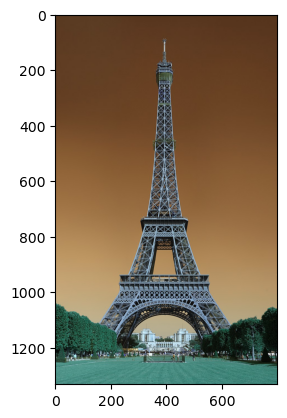

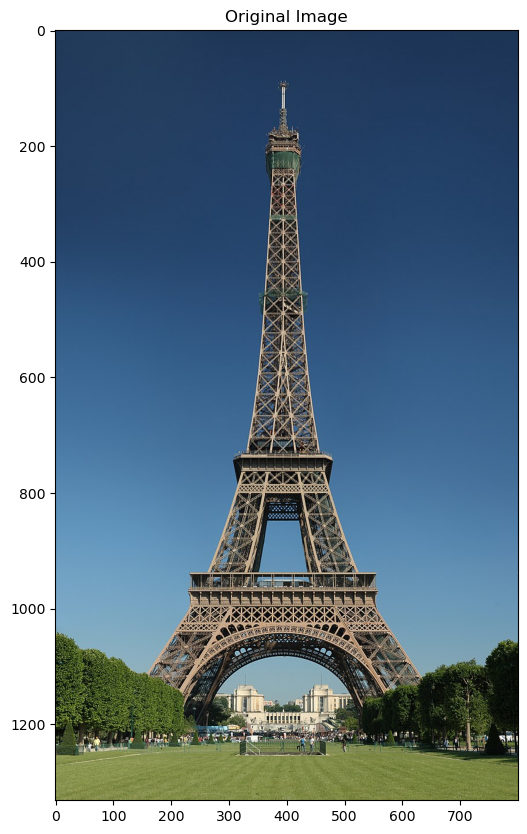

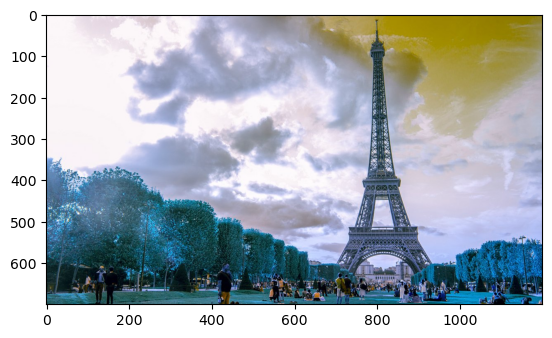

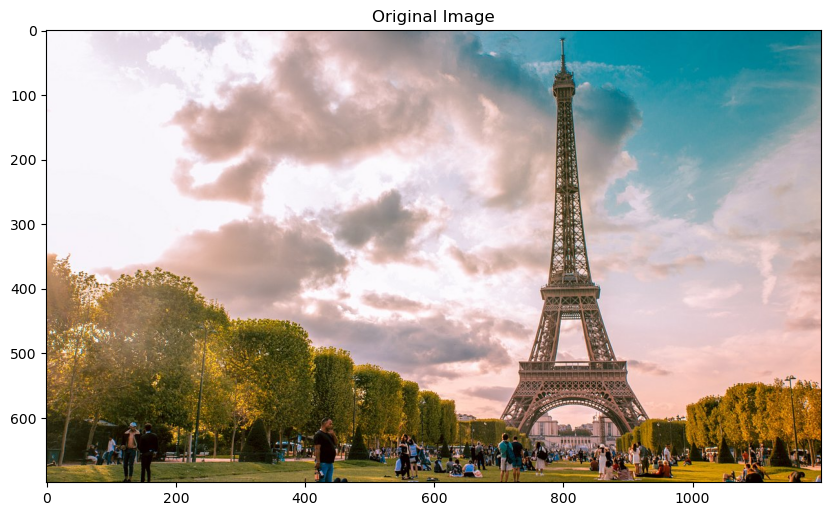

In [10]:
import matplotlib.pyplot as plt
import cv2

def plot_im(img, title, figsize=(10, 10)):
    plt.figure(figsize=figsize)
    plt.imshow(img)
    plt.title(title)
    plt.show()

def show_image(img):
    plt.imshow(img)
    plt.show()

eiffel = cv2.imread("../Images/eiffel.jpg")
eiffel2 = cv2.imread("../Images/eiffel2.jpg")

show_image(eiffel)

eiffel_colored = cv2.cvtColor(eiffel, cv2.COLOR_BGR2RGB)
plot_im(eiffel_colored, "Original Image")

show_image(eiffel2)

eiffel_colored2 = cv2.cvtColor(eiffel2, cv2.COLOR_BGR2RGB)
plot_im(eiffel_colored2, "Original Image")


<h2><b>Mean Filtering</b></h2><br>

Mean filtering, also known as average filtering, is a common technique used in image processing and signal processing to reduce noise or blur in an image or signal.

<br><img src = "../Images/mean_filtering.png"><br>

In mean filtering, each pixel in the image is replaced with the average value of its neighboring pixels.<br>

The purpose of mean filtering is to smooth out noise or unwanted variations in the image. By replacing each pixel with the average of its neighbors, high-frequency noise is suppressed, and the image appears smoother. Mean filtering is particularly effective in reducing Gaussian noise, which is a type of random noise that follows a Gaussian distribution.<br>

However, mean filtering also has its limitations. It tends to blur sharp edges and details in the image, which can result in loss of fine details. If preserving fine details is crucial, other types of filters, such as median filtering or Gaussian filtering, may be more suitable.<br>

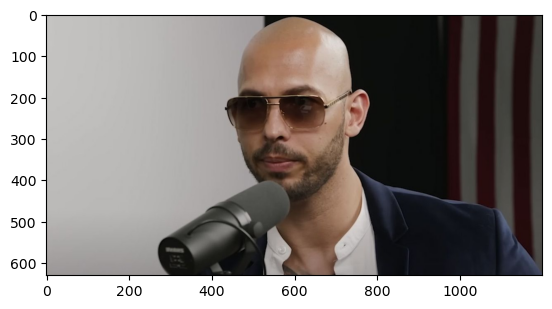

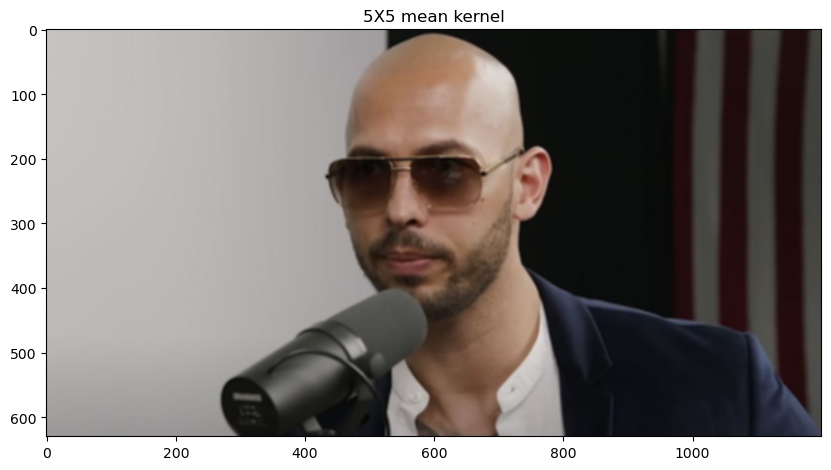

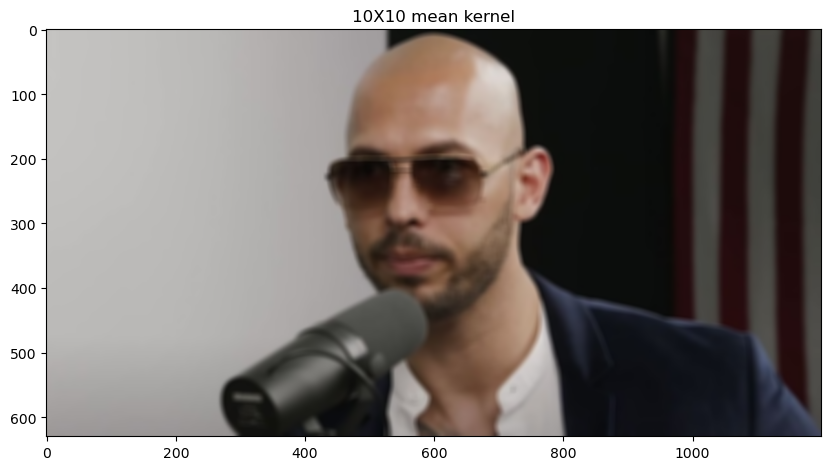

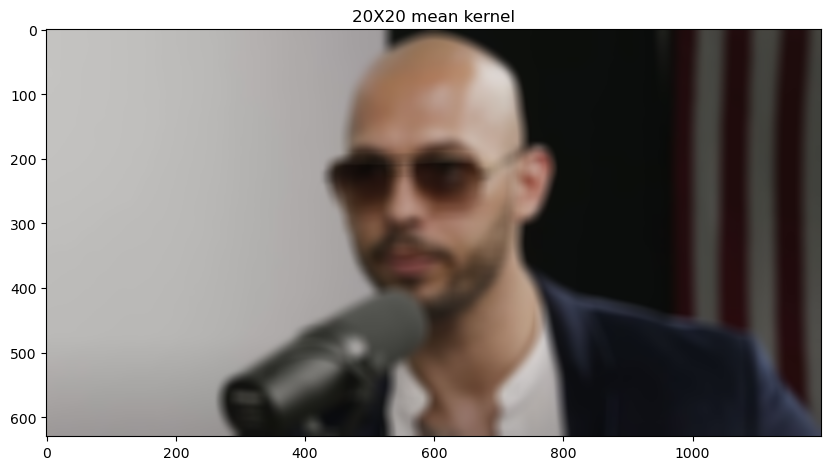

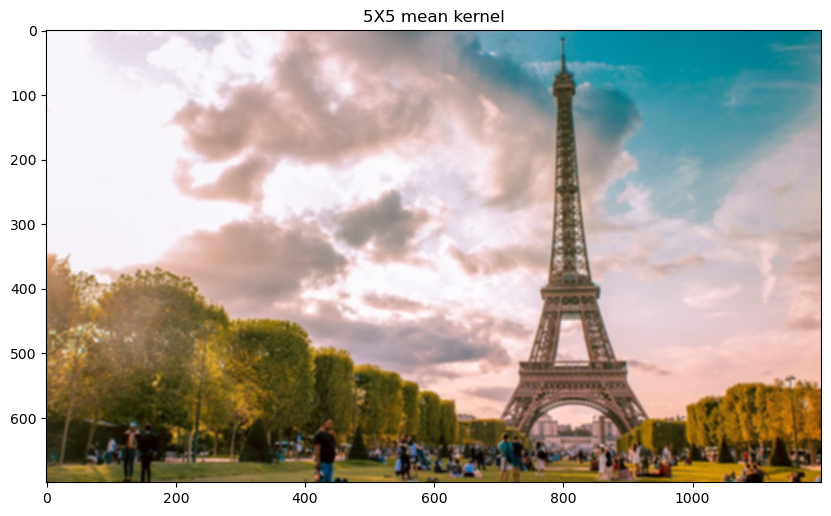

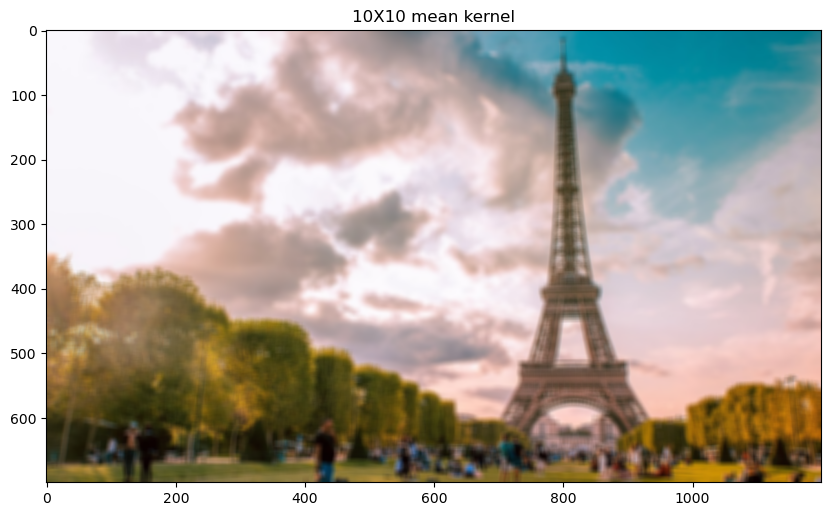

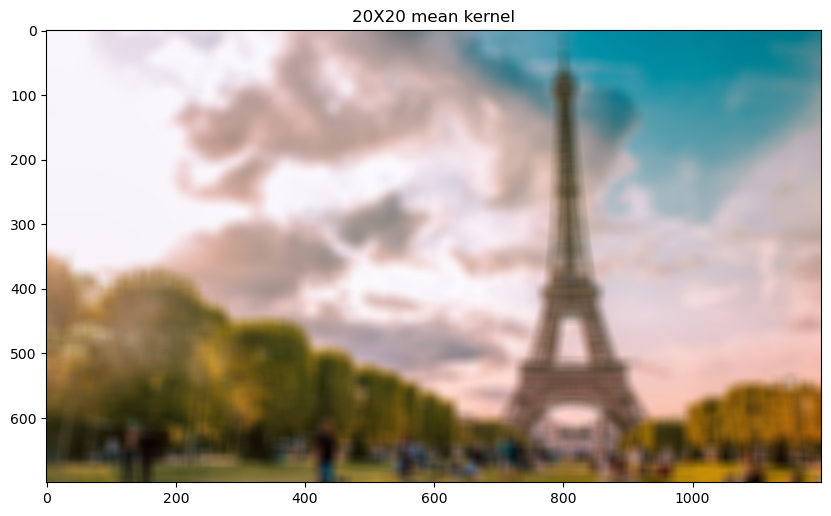

In [11]:
andrew_tate = cv2.cvtColor(cv2.imread("../Images/andrew_tate.jpg"), cv2.COLOR_BGR2RGB)
show_image(andrew_tate)

def mean_kernel_smoothing(img, sz):
    kernel = np.ones((sz, sz)) / (sz ** 2)
    #print(np.ones((sz, sz)))
    #print(sz ** 2)
    #print(kernel)
    dst = cv2.filter2D(img, -1, kernel)
    
    plot_im(dst, str(sz) + "X" + str(sz) + " mean kernel")

mean_kernel_smoothing(andrew_tate, 5)
mean_kernel_smoothing(andrew_tate, 10)
mean_kernel_smoothing(andrew_tate, 20)

mean_kernel_smoothing(eiffel_colored2, 5)
mean_kernel_smoothing(eiffel_colored2, 10)
mean_kernel_smoothing(eiffel_colored2, 20)


<h2><b>Median Filtering</b></h2><br>

Unlike mean filtering, which replaces each pixel with the average value of its neighboring pixels, median filtering replaces each pixel with the median value of its neighboring pixels.

<br><img src = "../Images/median_filtering.png"><br>

The purpose of median filtering is to preserve edges and details in the image while effectively reducing noise. Unlike mean filtering, median filtering is less likely to blur sharp edges and fine details. It is particularly effective in removing impulse noise or salt-and-pepper noise, where individual pixels have very high or very low values compared to their neighbors.

While both mean filtering and median filtering are used for noise reduction, they differ in their effects on the image. Mean filtering is more suited for reducing Gaussian noise or uniformly distributed noise, but it can blur edges and details. On the other hand, median filtering is more effective in removing impulse noise and preserving image details.

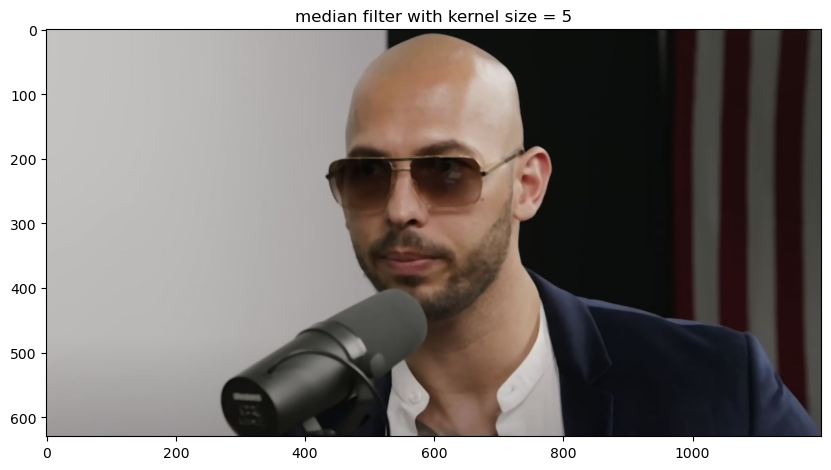

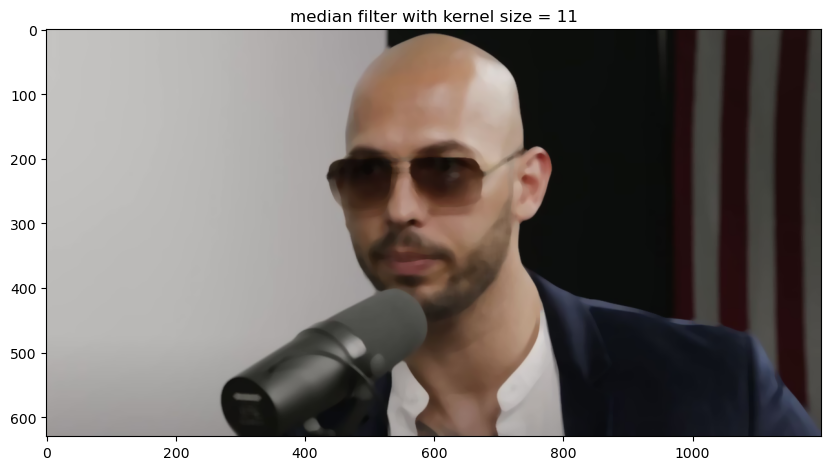

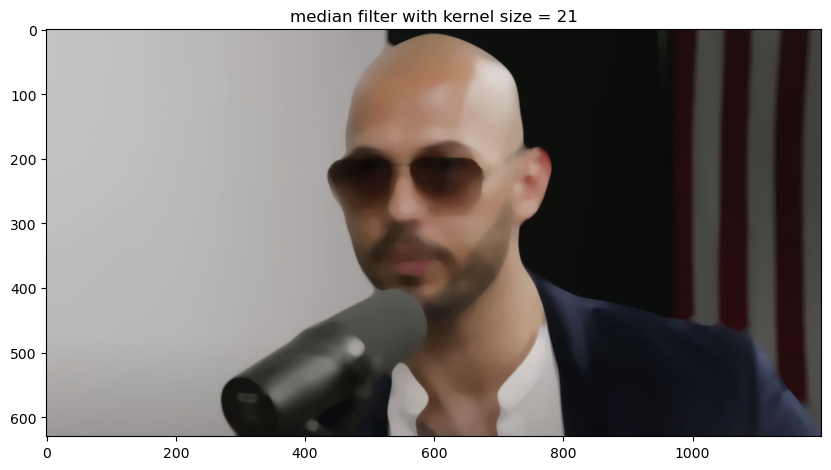

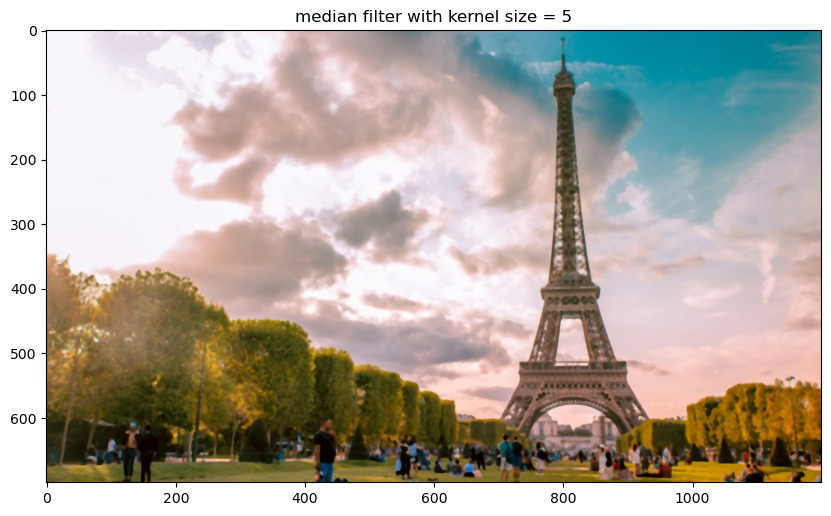

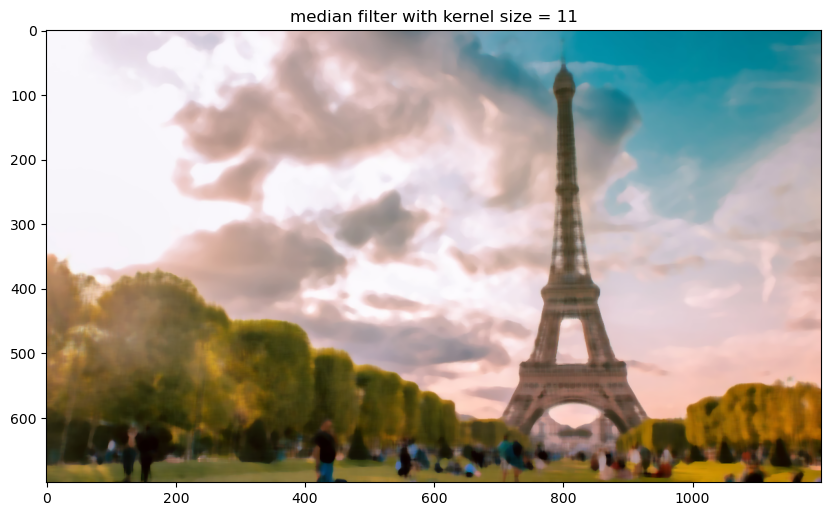

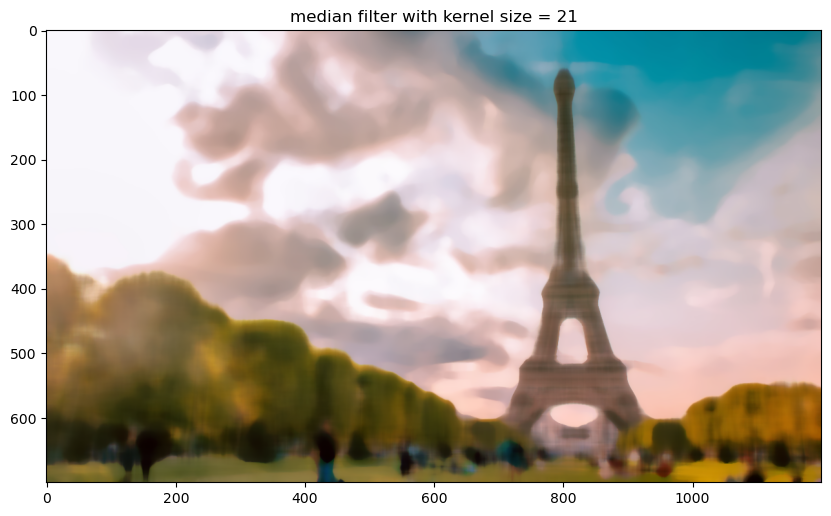

In [12]:
def median_filter(img, k_sz):
    if k_sz % 2 == 0:
        k_sz += 1  # Adjust kernel size to nearest odd number
    
    res = cv2.medianBlur(img, k_sz)
    plot_im(res, "median filter with kernel size = " + str(k_sz))

    
median_filter(andrew_tate, 5)
median_filter(andrew_tate, 10)
median_filter(andrew_tate, 20)

median_filter(eiffel_colored2, 5)
median_filter(eiffel_colored2, 10)
median_filter(eiffel_colored2, 20)
    

<h2><b>Gaussian Filter</b></h2><br>

Gaussian filtering is a widely used technique in image processing and signal processing for smoothing or blurring an image. It involves convolving the image with a Gaussian kernel, which is a two-dimensional distribution defined by the Gaussian function.

The Gaussian filter applies weights to each pixel in the image based on its distance from the center of the kernel. Pixels closer to the center have higher weights, while pixels farther away have lower weights. This weight distribution follows a bell-shaped curve, with the highest weight at the center and gradually decreasing weights towards the edges.

The Gaussian filter effectively reduces high-frequency noise in an image while preserving edges and fine details better than mean or median filters. It achieves this by attenuating high-frequency components in the image, which are more likely to correspond to noise or small variations.

The size of the Gaussian kernel, often referred to as the standard deviation or sigma (σ), determines the extent of blurring or smoothing. A larger sigma value results in a wider kernel and more smoothing, while a smaller sigma value produces a narrower kernel and less smoothing.

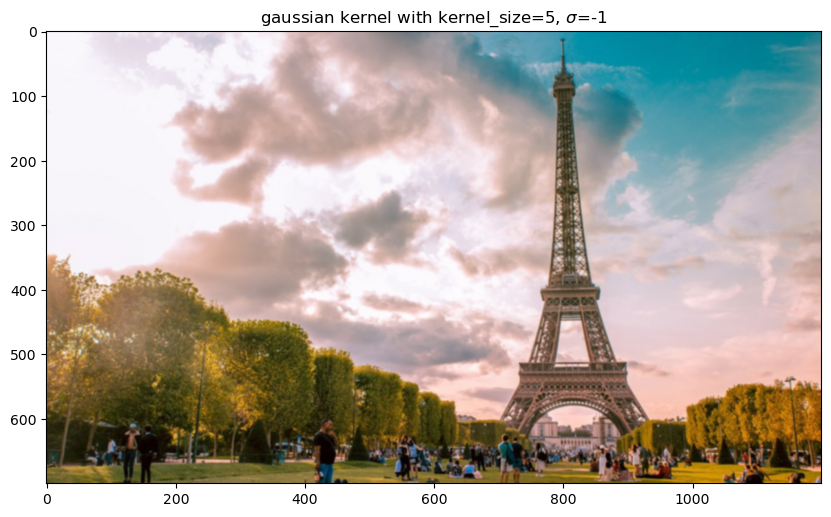

[[0.0625]
 [0.25  ]
 [0.375 ]
 [0.25  ]
 [0.0625]]


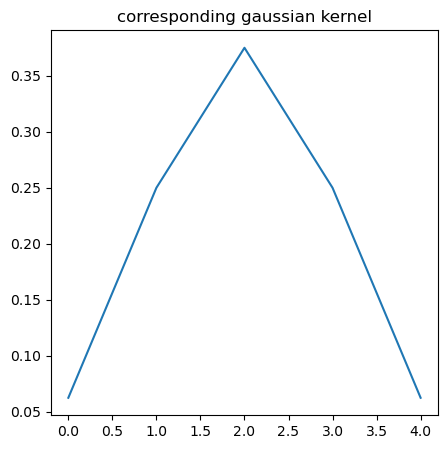

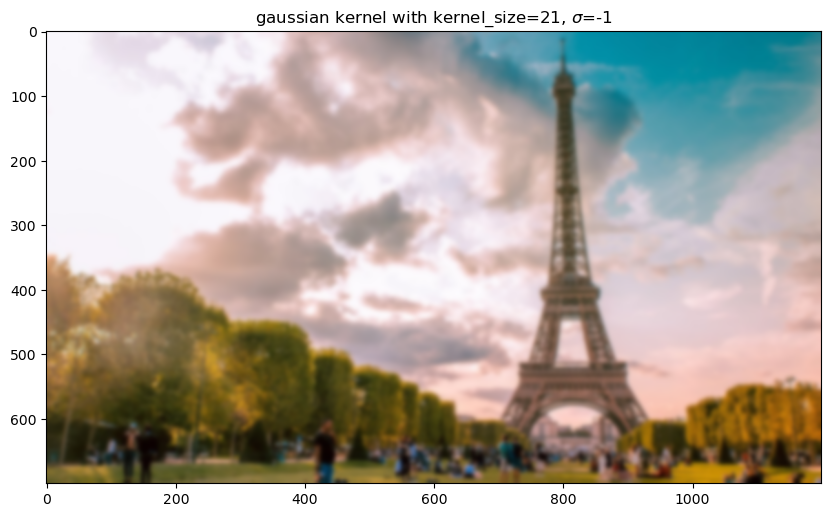

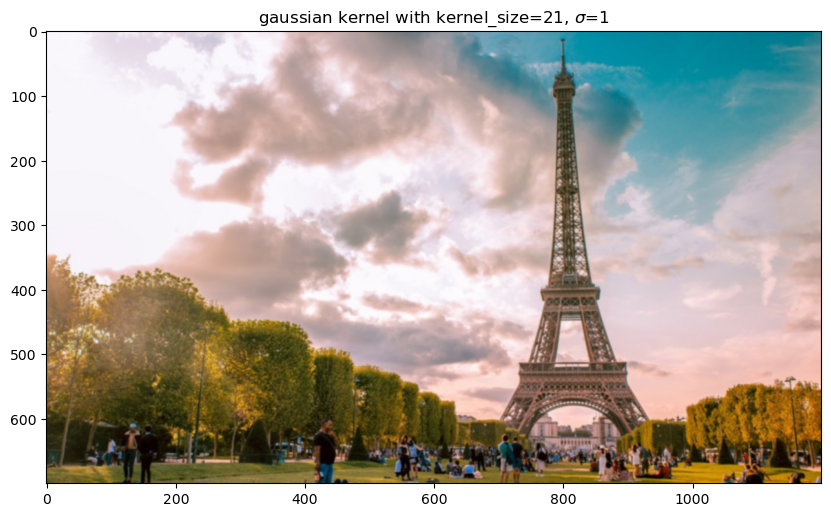

In [17]:
def gauss_blur(img, k_sz, sigma=-1, is_plot_kernel=False):
    blur = cv2.GaussianBlur(img, (k_sz, k_sz), sigma)
    plot_im(blur, "gaussian kernel with kernel_size=" + str(k_sz) + r", $\sigma$=" + str(sigma))
    if is_plot_kernel:
         #sigma=-1 will set the sigma size automatically
        gauss_ker = cv2.getGaussianKernel(k_sz, sigma)
        print(gauss_ker)
        plt.figure(figsize=(figsize[0] / 2, figsize[1] / 2))
        plt.plot(gauss_ker)
        plt.title("corresponding gaussian kernel")
        plt.show()


gauss_blur(eiffel_colored2, 5, is_plot_kernel=True)
gauss_blur(eiffel_colored2, 21, is_plot_kernel=False)
gauss_blur(eiffel_colored2, 21, 1, is_plot_kernel=False)


<h2><b>Noise Additon Function</h2></b><br>

In [20]:
def gauss_noise(image, gauss_var=1000):
    mean = 0
    sigma = gauss_var ** 0.5
    gauss = np.random.normal(mean, sigma, image.shape)

    res = image + gauss
    noisy = np.clip(res, 0, 255).astype(np.uint8)
    return noisy


def s_and_p_noise(image, s_p_ratio=0.04):
    # this implementation is not entirely correct because it assumes that
    # only 0 OR 255 values are S&P noise.
    out = np.copy(image)

    # Salt mode
    mask = np.random.rand(image.shape[0], image.shape[1]) <= s_p_ratio / 2
    out[mask] = 255

    # Pepper mode
    mask = np.random.rand(image.shape[0], image.shape[1]) <= s_p_ratio / 2
    out[mask] = 0
    return out


<h2><b>Gaussian Noise Tests</b></h2><br>

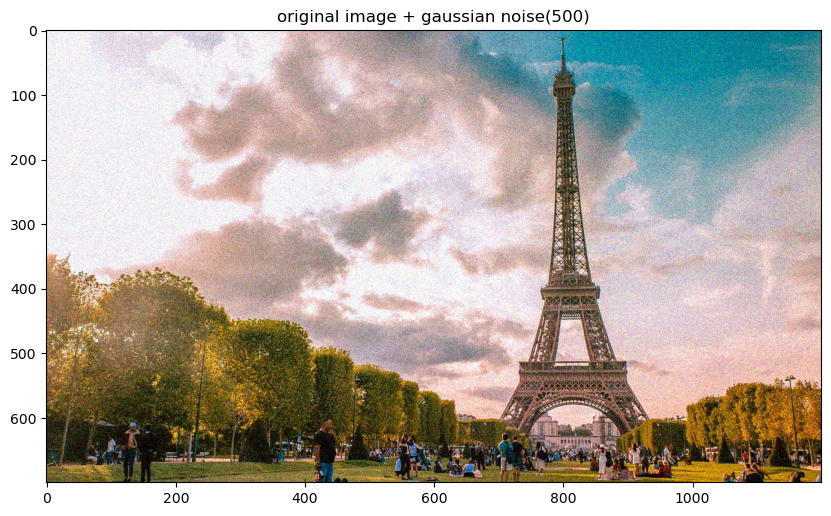

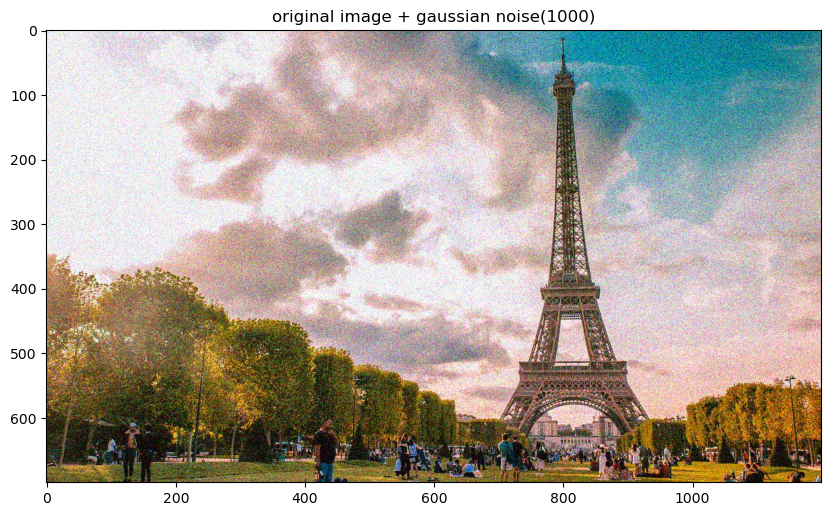

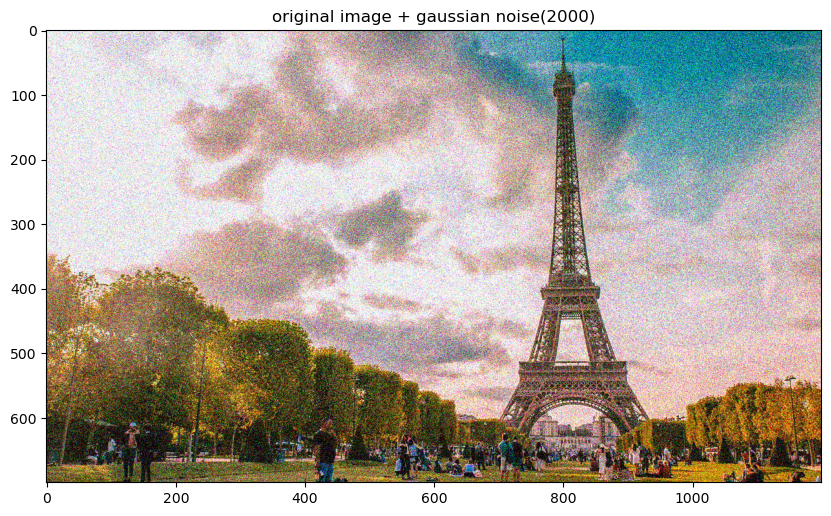

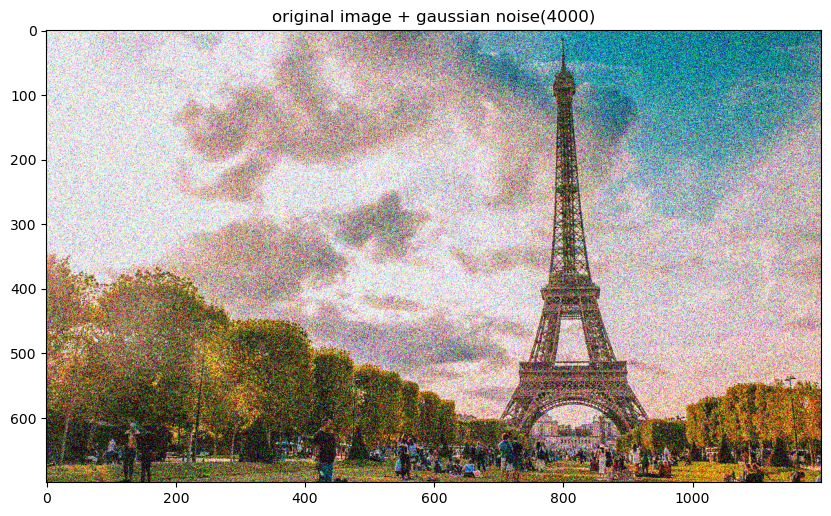

In [29]:
gauss_noise_im = gauss_noise(eiffel_colored2, gauss_var=500)
plt.figure(figsize=figsize)
plt.imshow(gauss_noise_im)
plt.title("original image + gaussian noise" + "(500)")
plt.show()

gauss_noise_im = gauss_noise(eiffel_colored2, gauss_var=1000)
plt.figure(figsize=figsize)
plt.imshow(gauss_noise_im)
plt.title("original image + gaussian noise" + "(1000)")
plt.show()

gauss_noise_im = gauss_noise(eiffel_colored2, gauss_var=2000)
plt.figure(figsize=figsize)
plt.imshow(gauss_noise_im)
plt.title("original image + gaussian noise" + "(2000)")
plt.show()

gauss_noise_im = gauss_noise(eiffel_colored2, gauss_var=4000)
plt.figure(figsize=figsize)
plt.imshow(gauss_noise_im)
plt.title("original image + gaussian noise" + "(4000)")
plt.show()

<h2><b>Salt and Pepper noise tests</b></h2><br>

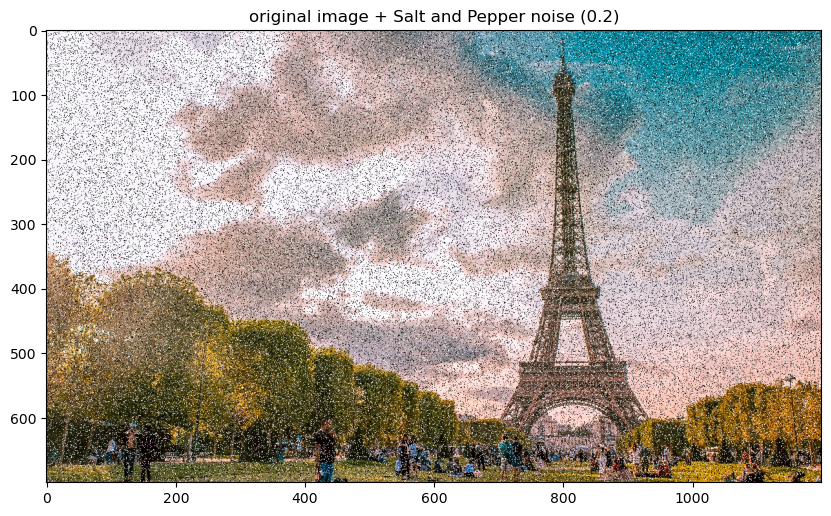

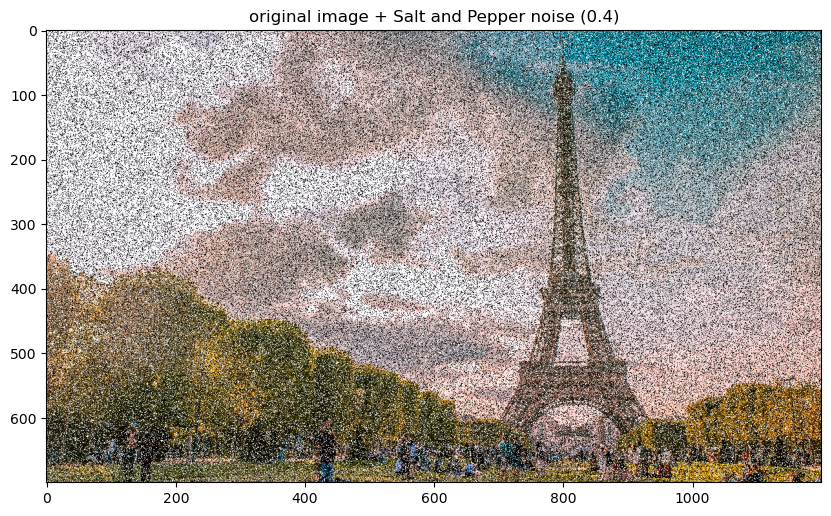

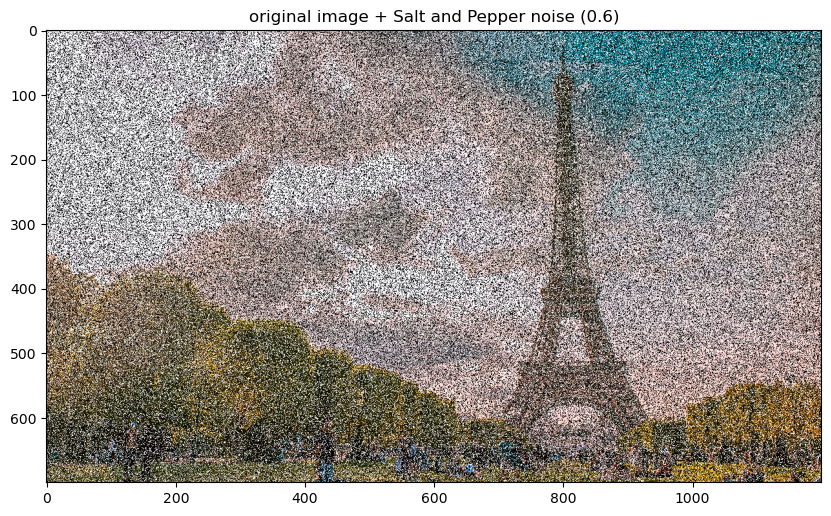

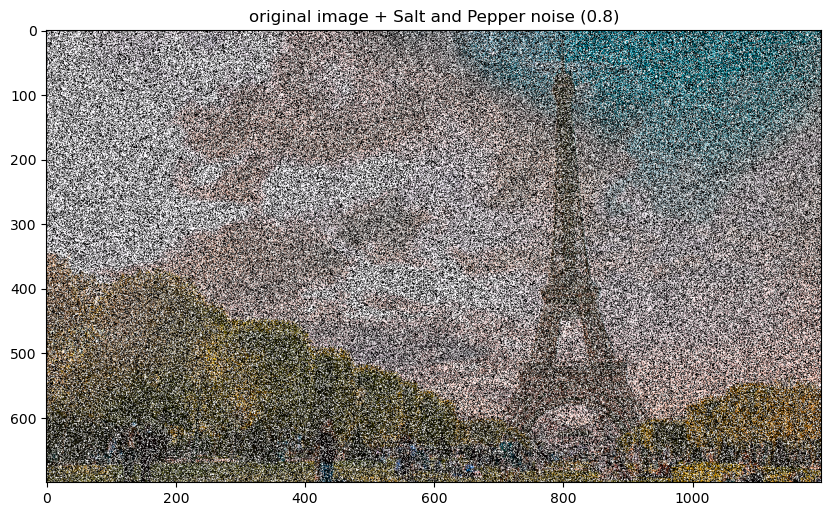

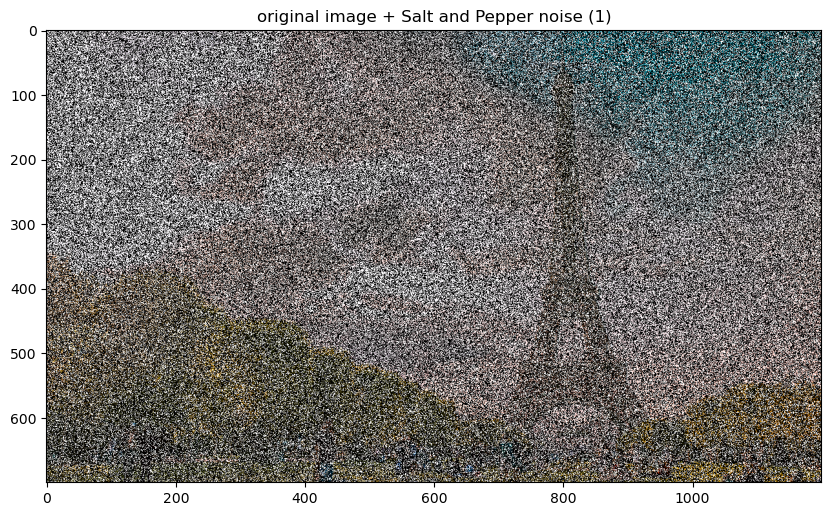

In [34]:
s_p_noise_im = s_and_p_noise(eiffel_colored2, s_p_ratio=0.2)
plt.figure(figsize=figsize)
plt.imshow(s_p_noise_im)
plt.title("original image + Salt and Pepper noise (0.2)")
plt.show()

s_p_noise_im = s_and_p_noise(eiffel_colored2, s_p_ratio=0.4)
plt.figure(figsize=figsize)
plt.imshow(s_p_noise_im)
plt.title("original image + Salt and Pepper noise (0.4)")
plt.show()

s_p_noise_im = s_and_p_noise(eiffel_colored2, s_p_ratio=0.6)
plt.figure(figsize=figsize)
plt.imshow(s_p_noise_im)
plt.title("original image + Salt and Pepper noise (0.6)")
plt.show()

s_p_noise_im = s_and_p_noise(eiffel_colored2, s_p_ratio=0.8)
plt.figure(figsize=figsize)
plt.imshow(s_p_noise_im)
plt.title("original image + Salt and Pepper noise (0.8)")
plt.show()

s_p_noise_im = s_and_p_noise(eiffel_colored2, s_p_ratio=1)
plt.figure(figsize=figsize)
plt.imshow(s_p_noise_im)
plt.title("original image + Salt and Pepper noise (1)")
plt.show()